Nou còdec: zlib
    
Còdecs: blosclz, zstd i zlib
    
CONCLUSIONS: no es solapen cap dels tres, pero zstd guanye sempre a zlib. Per tant, eliminem zstd.

Còdecs: blosclz i zlib

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import aux_funcs

In [2]:
from pathlib import Path
path = Path('../data_inputs_temp/')

In [3]:
ficheros = ['entropy-bitshuffle', 'blosclz-bitshuffle-split', 'zlib-bitshuffle-split']
categories = ["31", "0", "1"]

dataframes1 = {}
for i in range(len(ficheros)):
    dataframes1[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [4]:
path = Path('../data_inputs')

dataframes2 = {}
for i in range(len(ficheros)):
    dataframes2[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [5]:
path = Path('../data_inputs_wind/')

dataframes3 = {}
for i in range(len(ficheros)):
    dataframes3[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [6]:
df_fig = pd.DataFrame()
for i in range(0, len(ficheros)):
    df_fig = pd.concat([df_fig, dataframes1[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes2[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes3[ficheros[i]]], axis = 0)

df_fig

,cratio,speed,special_vals,nchunk,category,codec_filter,categoria
0,16400.00,5.390000e+09,1,0,-1,entropy-bitshuffle,31
1,156.00,8.070000e+09,0,0,-1,entropy-bitshuffle,31
2,1.89,2.420000e+09,0,0,-1,entropy-bitshuffle,31
3,156.00,1.250000e+10,0,0,-1,entropy-bitshuffle,31
4,16400.00,5.370000e+09,1,0,-1,entropy-bitshuffle,31
...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,215,11,zlib-bitshuffle-split,1
55292,16400.00,5.560000e+09,1,215,11,zlib-bitshuffle-split,1
55293,16400.00,5.600000e+09,1,215,11,zlib-bitshuffle-split,1
55294,16400.00,5.580000e+09,1,215,11,zlib-bitshuffle-split,1


In [7]:
df_fig = df_fig[df_fig['special_vals'] == 0]

In [8]:
fig = px.scatter(df_fig, "cratio", "speed", color = "categoria")
fig.show()

0: blosclz

1: zlib

# DATAFRAME FILTRE shuffle

In [9]:
#dataframes1[ficheros[1]]

In [10]:
df_entropy = pd.DataFrame()
df_entropy = pd.concat([df_entropy, dataframes1[ficheros[0]], dataframes2[ficheros[0]], 
                       dataframes3[ficheros[0]]], axis = 0)

df_entropy.rename(columns = {'cratio':'cratio31', 'speed':'speed31', 'special_vals':'special_vals31'}, inplace = True)
df_entropy = df_entropy.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [11]:
df_blosclz = pd.DataFrame()
df_blosclz = pd.concat([df_blosclz, dataframes1[ficheros[1]], dataframes2[ficheros[1]], 
                       dataframes3[ficheros[1]]], axis = 0)

df_blosclz.rename(columns = {'cratio':'cratio0', 'speed':'speed0', 'special_vals':'special_vals0'}, inplace = True)
df_blosclz = df_blosclz.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [12]:
df_zlib = pd.DataFrame()
df_zlib = pd.concat([df_zlib, dataframes1[ficheros[2]], dataframes2[ficheros[2]], 
                        dataframes3[ficheros[2]]], axis = 0)

df_zlib.rename(columns = {'cratio':'cratio1', 'speed':'speed1', 'special_vals':'special_vals1'}, inplace = True)
df_zlib = df_zlib.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [13]:
df_shuffle = pd.DataFrame()
df_shuffle = pd.concat([df_shuffle, df_blosclz, df_zlib, df_entropy], axis = 1)
df_shuffle

,cratio0,speed0,special_vals0,cratio1,speed1,special_vals1,cratio31,speed31,special_vals31
0,16400.00,5.540000e+09,1,16400.00,5.540000e+09,1,16400.00,5.390000e+09,1
1,1.00,1.930000e+09,0,3.29,3.610000e+07,0,156.00,8.070000e+09,0
2,5.67,3.830000e+08,0,13.00,5.710000e+07,0,1.89,2.420000e+09,0
3,226.00,3.810000e+09,0,676.00,2.140000e+08,0,156.00,1.250000e+10,0
4,16400.00,5.390000e+09,1,16400.00,5.560000e+09,1,16400.00,5.370000e+09,1
...,...,...,...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1,16400.00,5.560000e+09,1,16400.00,5.600000e+09,1
55292,16400.00,5.560000e+09,1,16400.00,5.560000e+09,1,16400.00,5.170000e+09,1
55293,16400.00,5.580000e+09,1,16400.00,5.600000e+09,1,16400.00,5.260000e+09,1
55294,16400.00,5.520000e+09,1,16400.00,5.580000e+09,1,16400.00,5.240000e+09,1


Eliminar special_value (que lo sea en alguna de las 3 categorías)


In [14]:
df_shuffle_aux = aux_funcs.delete_special_vals(df_shuffle, ["special_vals0", "special_vals1", "special_vals31"])

In [15]:
df_input_x = df_shuffle.iloc[:, [6, 7]]

In [16]:
df_input_x

,cratio31,speed31
0,16400.00,5.390000e+09
1,156.00,8.070000e+09
2,1.89,2.420000e+09
3,156.00,1.250000e+10
4,16400.00,5.370000e+09
...,...,...
55291,16400.00,5.600000e+09
55292,16400.00,5.170000e+09
55293,16400.00,5.260000e+09
55294,16400.00,5.240000e+09


Cálculo del SCORE

In [17]:
df_shuffle = df_shuffle.drop(['cratio31', 'speed31', 'special_vals31', 'special_vals0', 'special_vals1'], axis = 1)

In [18]:
df_shuffle

,cratio0,speed0,cratio1,speed1
0,16400.00,5.540000e+09,16400.00,5.540000e+09
1,1.00,1.930000e+09,3.29,3.610000e+07
2,5.67,3.830000e+08,13.00,5.710000e+07
3,226.00,3.810000e+09,676.00,2.140000e+08
4,16400.00,5.390000e+09,16400.00,5.560000e+09
...,...,...,...,...
55291,16400.00,5.560000e+09,16400.00,5.560000e+09
55292,16400.00,5.560000e+09,16400.00,5.560000e+09
55293,16400.00,5.580000e+09,16400.00,5.600000e+09
55294,16400.00,5.520000e+09,16400.00,5.580000e+09


In [19]:
dfcratios = pd.DataFrame()
for i in range(0, 2):
    dfcratios = pd.concat([dfcratios, df_shuffle.iloc[:, 2*i]], axis =0)

In [20]:
desv_cratio = dfcratios.std()[0]
desv_cratio

8141.8572691500085

In [21]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

7685.459618055554

In [22]:
dfspeeds = pd.DataFrame()
for i in range(0, 2):
    dfspeeds = pd.concat([dfspeeds, df_shuffle.iloc[:, 2*i+1]], axis =0)

In [23]:
mean_speed = dfspeeds.mean()[0]
mean_speed

3279087050.5099826

In [24]:
desv_speed = dfspeeds.std()[0]
desv_speed

2811110954.009355

In [25]:
theta = 0.95

cratio0 = df_shuffle["cratio0"]
speed0 = df_shuffle["speed0"]
ncratio0 = (cratio0 - mean_cratio) / desv_cratio
nspeed0 = (speed0 - mean_speed) / desv_speed
df_shuffle.insert(2, 0, theta*ncratio0 + (1-theta)*nspeed0)

cratio1 = df_shuffle["cratio1"]
speed1 = df_shuffle["speed1"]
ncratio1 = (cratio1 - mean_cratio) / desv_cratio
nspeed1 = (speed1 - mean_speed) / desv_speed
df_shuffle.insert(5, 1, theta*ncratio1 + (1-theta)*nspeed1)

In [26]:
df_shuffle

,cratio0,speed0,0,cratio1,speed1,1
0,16400.00,5.540000e+09,1.057035,16400.00,5.540000e+09,1.057035
1,1.00,1.930000e+09,-0.920626,3.29,3.610000e+07,-0.954045
2,5.67,3.830000e+08,-0.947597,13.00,5.710000e+07,-0.952538
3,226.00,3.810000e+09,-0.860934,676.00,2.140000e+08,-0.872388
4,16400.00,5.390000e+09,1.054367,16400.00,5.560000e+09,1.057391
...,...,...,...,...,...,...
55291,16400.00,5.560000e+09,1.057391,16400.00,5.560000e+09,1.057391
55292,16400.00,5.560000e+09,1.057391,16400.00,5.560000e+09,1.057391
55293,16400.00,5.580000e+09,1.057747,16400.00,5.600000e+09,1.058102
55294,16400.00,5.520000e+09,1.056679,16400.00,5.580000e+09,1.057747


In [27]:
df_pos = df_shuffle
df_pos = df_pos.drop(['cratio0', 'speed0', 'cratio1', 'speed1'], axis = 1)

In [28]:
df_pos

,0,1
0,1.057035,1.057035
1,-0.920626,-0.954045
2,-0.947597,-0.952538
3,-0.860934,-0.872388
4,1.054367,1.057391
...,...,...
55291,1.057391,1.057391
55292,1.057391,1.057391
55293,1.057747,1.058102
55294,1.056679,1.057747


EJERCICIO TOIA

In [30]:
col = df_pos.iloc[:, 0]
df = col.to_frame(name='punct')
df

df_0 = pd.DataFrame()
df_0 = pd.concat([df_0, df], axis = 0)
categoria = np.repeat(str(0), df_0.__len__())
df_0['categoria'] = categoria
df_0

,punct,categoria
0,1.057035,0
1,-0.920626,0
2,-0.947597,0
3,-0.860934,0
4,1.054367,0
...,...,...
55291,1.057391,0
55292,1.057391,0
55293,1.057747,0
55294,1.056679,0


In [32]:
col = df_pos.iloc[:, 1]
df = col.to_frame(name='punct')
df

df_1 = pd.DataFrame()
df_1 = pd.concat([df_1, df], axis = 0)
categoria = np.repeat('1', df_1.__len__())
df_1['categoria'] = categoria
df_1

,punct,categoria
0,1.057035,1
1,-0.954045,1
2,-0.952538,1
3,-0.872388,1
4,1.057391,1
...,...,...
55291,1.057391,1
55292,1.057391,1
55293,1.058102,1
55294,1.057747,1


In [33]:
df_fig = pd.DataFrame()
df_fig = pd.concat([df_fig, df_0, df_1], axis = 0)
df_fig

,punct,categoria
0,1.057035,0
1,-0.920626,0
2,-0.947597,0
3,-0.860934,0
4,1.054367,0
...,...,...
55291,1.057391,1
55292,1.057391,1
55293,1.058102,1
55294,1.057747,1


In [34]:
fig = px.scatter(df_fig, "punct", "categoria", color = "categoria")
fig.show()

FIN EJERCICIO

In [35]:
best_categ_shuffle = df_pos.idxmax(axis=1)
best_categ_shuffle = pd.DataFrame(best_categ_shuffle, columns=['best_categ'])
best_categ_shuffle

,best_categ
0,0
1,0
2,0
3,0
4,1
...,...
55291,0
55292,0
55293,1
55294,1


In [36]:
categorias = best_categ_shuffle['best_categ'].unique()

In [37]:
unique, counts = np.unique(best_categ_shuffle, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[     0, 136907],
       [     1,  28981]])

In [38]:
df_t = pd.DataFrame()
df_t = pd.concat([df_t, df_input_x['cratio31']], axis = 1)
df_t = pd.concat([df_t, df_input_x['speed31']], axis = 1)
df_t = pd.concat([df_t, best_categ_shuffle], axis = 1)
df_t

,cratio31,speed31,best_categ
0,16400.00,5.390000e+09,0
1,156.00,8.070000e+09,0
2,1.89,2.420000e+09,0
3,156.00,1.250000e+10,0
4,16400.00,5.370000e+09,1
...,...,...,...
55291,16400.00,5.600000e+09,0
55292,16400.00,5.170000e+09,0
55293,16400.00,5.260000e+09,1
55294,16400.00,5.240000e+09,1


Balancear

In [39]:
df_blc = pd.DataFrame()
for i in categorias:
    df_i = df_t[df_t['best_categ'] == i]
    df_i = df_i.head(n=38981)
    df_blc = pd.concat([df_blc, df_i], axis = 0)
        
df_blc

,cratio31,speed31,best_categ
0,16400.00,5.390000e+09,0
1,156.00,8.070000e+09,0
2,1.89,2.420000e+09,0
3,156.00,1.250000e+10,0
5,156.00,8.460000e+09,0
...,...,...,...
55285,16400.00,5.580000e+09,1
55287,16400.00,5.580000e+09,1
55290,16400.00,5.580000e+09,1
55293,16400.00,5.260000e+09,1


In [40]:
dfinput_y = pd.DataFrame()
dfinput_y = pd.concat([dfinput_y, df_blc['best_categ']], axis = 1)
dfinput_y.shape

(67962, 1)

In [41]:
dfinput_x = df_blc.drop(['best_categ'], axis = 1)
dfinput_x.shape

(67962, 2)

Normalizar inputs

In [42]:
dfcratios = pd.DataFrame()
dfcratios = pd.concat([dfcratios, dfinput_x.iloc[:, 0]], axis =0)

In [43]:
desv_cratio = dfcratios.std()[0]
desv_cratio

8130.024894081541

In [44]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

8793.140793237399

In [45]:
dfspeeds = pd.DataFrame()
dfspeeds = pd.concat([dfspeeds, dfinput_x.iloc[:, 1]], axis =0)

In [46]:
mean_speed = dfspeeds.mean()[0]
mean_speed

7429650083.8703985

In [47]:
desv_speed = dfspeeds.std()[0]
desv_speed

3594271996.1229873

In [48]:
dfinput_x

,cratio31,speed31
0,16400.00,5.390000e+09
1,156.00,8.070000e+09
2,1.89,2.420000e+09
3,156.00,1.250000e+10
5,156.00,8.460000e+09
...,...,...
55285,16400.00,5.580000e+09
55287,16400.00,5.580000e+09
55290,16400.00,5.580000e+09
55293,16400.00,5.260000e+09


In [49]:
cratio = dfinput_x["cratio31"]
speed = dfinput_x["speed31"]
ncratio = (cratio - mean_cratio) / desv_cratio
nspeed = (speed - mean_speed) / desv_speed

dfinput_x_norm = pd.DataFrame()
dfinput_x_norm.insert(0, "ncratio", ncratio)
dfinput_x_norm.insert(1, "nspeed", nspeed)

In [50]:
dfinput_x_norm

,ncratio,nspeed
0,0.935650,-0.567472
1,-1.062376,0.178158
2,-1.081331,-1.393787
3,-1.062376,1.410675
5,-1.062376,0.286664
...,...,...
55285,0.935650,-0.514610
55287,0.935650,-0.514610
55290,0.935650,-0.514610
55293,0.935650,-0.603641


In [51]:
dfinput_x = dfinput_x_norm

In [52]:
dfinput_y

,best_categ
0,0
1,0
2,0
3,0
5,0
...,...
55285,1
55287,1
55290,1
55293,1


In [53]:
#dfinput_x = dfinput_x.to_csv('dfinput_x.csv')
#dfinput_y = dfinput_y.to_csv('dfinput_y.csv')

In [54]:
dfinput_y

,best_categ
0,0
1,0
2,0
3,0
5,0
...,...
55285,1
55287,1
55290,1
55293,1


In [55]:
dfinput_x.shape

(67962, 2)

In [56]:
dfinput_y.shape

(67962, 1)

# RED NEURONAL (2 categorías)

In [57]:
from keras.utils import to_categorical
dfinput_y = to_categorical(dfinput_y)

2022-12-28 11:58:43.720811: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [58]:
from keras import models, layers
import tensorflow

tensorflow.random.set_seed(100)

model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(2,)))
model.add(layers.Dense(15, activation='relu'))
model.add(layers.Dense(2, activation='softmax'))

2022-12-28 11:58:53.413757: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [59]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [60]:
history = model.fit(dfinput_x, dfinput_y, epochs=35, validation_split=0.1)

Epoch 1/35
1912/1912 [==============================] - 5s 2ms/step - loss: 0.3361 - acc: 0.8344 - val_loss: 0.7074 - val_acc: 0.9422
Epoch 2/35
1912/1912 [==============================] - 4s 2ms/step - loss: 0.2641 - acc: 0.8523 - val_loss: 0.6804 - val_acc: 0.9431
Epoch 3/35
1912/1912 [==============================] - 3s 2ms/step - loss: 0.2636 - acc: 0.8523 - val_loss: 0.5855 - val_acc: 0.9456
Epoch 4/35
1912/1912 [==============================] - 3s 2ms/step - loss: 0.2634 - acc: 0.8523 - val_loss: 0.7203 - val_acc: 0.9389
Epoch 5/35
1912/1912 [==============================] - 3s 2ms/step - loss: 0.2631 - acc: 0.8527 - val_loss: 0.7489 - val_acc: 0.9261
Epoch 6/35
1912/1912 [==============================] - 3s 2ms/step - loss: 0.2635 - acc: 0.8525 - val_loss: 0.6747 - val_acc: 0.9422
Epoch 7/35
1912/1912 [==============================] - 3s 2ms/step - loss: 0.2632 - acc: 0.8522 - val_loss: 0.6314 - val_acc: 0.9439
Epoch 8/35
1912/1912 [==============================] - 3s 2ms

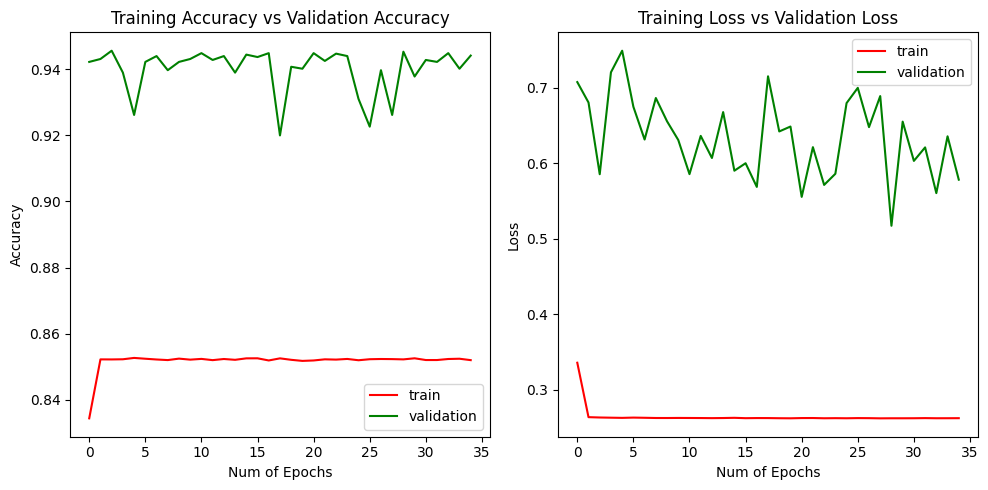

In [61]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

In [62]:
y_hat = model.predict(x=dfinput_x)
y_hat

2124/2124 [==============================] - 2s 1ms/step


array([[3.5359231e-01, 6.4640778e-01],
       [9.8730320e-01, 1.2696800e-02],
       [9.9936324e-01, 6.3679845e-04],
       ...,
       [3.1027868e-01, 6.8972135e-01],
       [3.8473406e-01, 6.1526591e-01],
       [3.8961741e-01, 6.1038256e-01]], dtype=float32)

In [63]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(dfinput_y, axis = 1)

In [64]:
y_pred_label

array([1, 0, 0, ..., 1, 1, 1])

In [65]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 32879],
       [    1, 35083]])

In [66]:
y_true_label

array([0, 0, 0, ..., 1, 1, 1])

In [67]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 38981],
       [    1, 28981]])

In [68]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla


col_0,0,1
row_0,,
0,31257,1622
1,7724,27359
